In [1]:
import numpy as np
import matplotlib.pyplot as plt
import time
from numba import jit
from scipy import optimize

In [2]:
r_0 = 200 # microns
d_0 = 25 # microns

In [3]:
def line_y(x,x_0,y_0,theta):
    # returns the y values of the line for all values in x
    # assumes that the line passes through (x_0 , y_0) and has the slope m = tan(theta) 
    m = np.tan(theta)
    c = y_0 - m*x_0
    y = m*x + c
    return y


def draw_blade1(r_0,d_0,theta,phi,grid_size,grid_spacing):
    theta1 = theta + np.pi/2
    x_0 = r_0* np.cos(theta)
    y_0 = r_0 * np.sin(theta)
    x_1 = x_0 + d_0 * np.cos(theta1)
    y_1 = y_0 + d_0 * np.sin(theta1)
    x_2 = x_0 - d_0 * np.cos(theta1)
    y_2 = y_0 - d_0 * np.sin(theta1)
    xlen = ylen = grid_size #microns
    step = grid_spacing
    xaxis = np.arange(-xlen,xlen + step,step)
    yaxis = np.arange(-ylen,ylen + step,step)
    X,Y = np.meshgrid(xaxis,yaxis)
    elec = np.empty((X.shape[0],X.shape[1]))
    elec.fill(0)
    for i in range(0,X.shape[0]):
        for j in range(0,X.shape[1]):
            if (Y[j,i] > line_y(X[j,i],x_0,y_0,theta + np.pi/2)) &  (Y[j,i] < line_y(X[j,i],x_1,y_1,theta + phi)) & (Y[j,i] > line_y(X[j,i],x_2,y_2,theta - phi)):
                elec[j,i] = 1
    return elec


def ref_x(elec):
    elec1 = np.empty((elec.shape[0],elec.shape[1]))
    elec1.fill(0)
    for i in range(0,elec.shape[0]):
        for j in range(0,elec.shape[1]):
            if elec[i,j] == 1 :
                elec1[elec.shape[0]-i-1,j] = 1
    return elec1

def ref_y(elec):
    elec1 = np.empty((elec.shape[0],elec.shape[1]))
    elec1.fill(0)
    for i in range(0,elec.shape[0]):
        for j in range(0,elec.shape[1]):
            if elec[i,j] == 1 :
                elec1[i,elec.shape[0]-j-1] = 1
    return elec1

def ref_xy(elec):
    elec1 = np.empty((elec.shape[0],elec.shape[1]))
    elec1.fill(0)
    for i in range(0,elec.shape[0]):
        for j in range(0,elec.shape[1]):
            if elec[i,j] == 1 :
                elec1[elec.shape[0]-i-1,elec.shape[0]-j-1] = 1
    return elec1


def draw_blades(r_0,d_0,theta,phi,grid_size,grid_spacing):
    blade1  = draw_blade1(d_0=25,grid_size=1000,grid_spacing=1,phi=phi,r_0=r_0,theta=theta)
    blade2 = ref_x(blade1)
    blade3 = ref_y(blade1)
    blade4 = ref_xy(blade1)
    blades = blade1 - blade2 - blade3 + blade4
    return blades

In [143]:
%%time
theta =  45 * (np.pi/180) # 45 degrees
phi = 5 * (np.pi/180) # 5 degrees
r_0 = 200
d_0 = 25
grid_size = 1000
grid_spacing = 1
xlen = ylen = grid_size #microns
step = grid_spacing
xaxis = np.arange(-xlen,xlen + step,step)
yaxis = np.arange(-ylen,ylen + step,step)
X,Y = np.meshgrid(xaxis,yaxis)
blades  = draw_blades(d_0=25,grid_size=size,grid_spacing=grid_spacing,phi=phi,r_0=r_0,theta=theta)

Wall time: 1min 14s


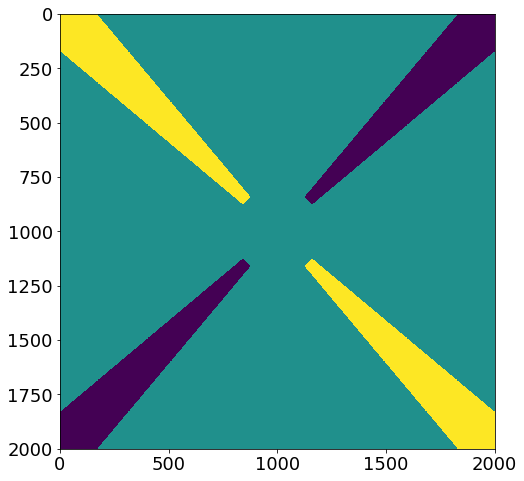

In [144]:
fig = plt.figure(figsize = (8,8))
ax1 = fig.add_subplot(111)
ax1.imshow(blades)
plt.show()

In [6]:
def set_grid_points(blades):
    grid_points = []
    for i in range(0,blades.shape[0]-1):
        for j in range(0,blades.shape[1]-1):
            if blades[i,j] == 0 :
                grid_points.append((i,j))
    return grid_points



@jit
def fast_numb_solve_test(blades,gp,iterations,tol):
    #largest_update = 0
    for iteration in range(0,iterations):
        largest_update = 0
        for grid_point in gp:
            i = grid_point[0]
            j = grid_point[1]
            value = 0.25 * (blades[i+1,j] + blades[i-1,j] + blades[i,j+1] + blades[i,j-1])
            update = np.abs(value - blades[i,j])
            blades[i,j] = value 
            if update > largest_update : 
                largest_update = update
        if largest_update < tol:
            break
    #print("the number of iteration is {}" .format(iteration))
    #print("solution tolerence is {}" .format(largest_update))
    return blades

In [26]:
%%time
theta =  45 * (np.pi/180) # 45 degrees
phi = 5 * (np.pi/180) # 5 degrees
r_0 = 200
d_0 = 25
size = 1000
grid_spacing = 1
blades  = draw_blades(d_0=25,grid_size=size,grid_spacing=grid_spacing,phi=phi,r_0=r_0,theta=theta)
grid_points = set_grid_points(blades)
soln = fast_numb_solve_test(blades,grid_points,50000,1e-5)

Wall time: 6min 51s


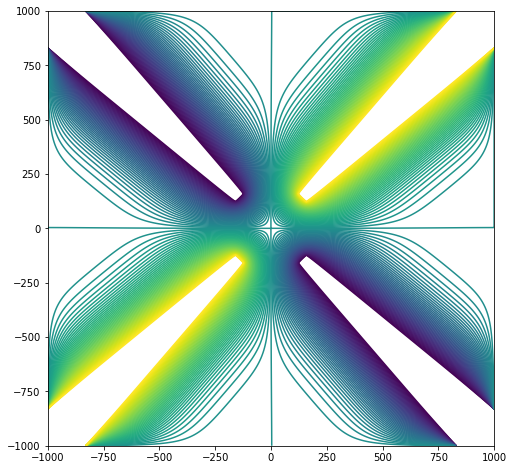

In [27]:
fig = plt.figure(figsize = (8,8))
ax1 = fig.add_subplot(111)
ax1.contour(X,Y,soln,100)
plt.show()

In [15]:
q = 1.60217662*(10**(-19))
m = 2.8395214559472*10**(-25) 
freq = 35 * 10**6
omega = 2*np.pi*freq

In [36]:
def get_pseudo(X,Y,soln):
    
    X_trunc = X[990:1011,990:1011]
    Y_trunc = Y[990:1011,990:1011]
    soln_trunc = 385*soln[990:1011,990:1011]
    Ex,Ey= np.gradient(soln_trunc,10**(-6))
    Vps = (np.square(Ex) + np.square(Ey) )*(q**2/(4*m*omega**2))
    return Vps, X_trunc, Y_trunc

def fitfunc(xdata,K_x,K_y,const):
    # fit function if the form (1/2)( K_x * x**2  + K_x * x**2  + const )
    # used by scipy.optimize
    return 0.5 * (K_x * xdata[0,:]**2 + K_y * xdata[1,:]**2) + const


def trapfreq(k):
    return np.sqrt(np.abs(k)/m)/(2*np.pi)


def get_trap_freq(Vps, X_trunc, Y_trunc):
    fitdata = np.zeros([2,X_trunc.size])
    fitdata[0,:] = X_trunc.reshape(X_trunc.size) * 10**(-6)
    fitdata[1,:] = Y_trunc.reshape(Y_trunc.size) * 10**(-6)
    fitdata_values = Vps.reshape(Vps.size)
    popt_pseudo, pconv_pseudo = optimize.curve_fit(fitfunc,fitdata,fitdata_values,[7E-12,7E-12,1E-19])
    w = trapfreq(popt_pseudo)
    return w[0:2]



def solve_geometry(theta,phi):
    theta_blades =  theta * (np.pi/180) # 45 degrees
    phi_chamfer = phi * (np.pi/180) # 5 degrees
    r_0 = 200
    d_0 = 25
    size = 1000
    grid_spacing = 1
    blades  = draw_blades(d_0=25,grid_size=size,grid_spacing=grid_spacing,phi=phi_chamfer,r_0=r_0,theta=theta_blades)
    grid_points = set_grid_points(blades)
    soln = fast_numb_solve_test(blades,grid_points,50000,1e-5)
    np.save('blade_trap_data/Variables/' + 'blade_angle_' + str(theta) + '_blade_chamfer_' + str(phi) + '_solved.npy',soln)

    #plotting the solution

    fig = plt.figure(figsize = (8,8))
    ax1 = fig.add_subplot(111)
    ax1.contour(X,Y,soln,100)
    plt.savefig('blade_trap_data/Pictures/' + 'blade_angle_' + str(theta) + '_blade_chamfer_' + str(phi) + '_solved.jpg')
    plt.show()

    # Finding the trap frequencies

    V_pseudo, X_trunc, Y_trunc = get_pseudo(X,Y,soln)
    return get_trap_freq(V_pseudo, X_trunc, Y_trunc)

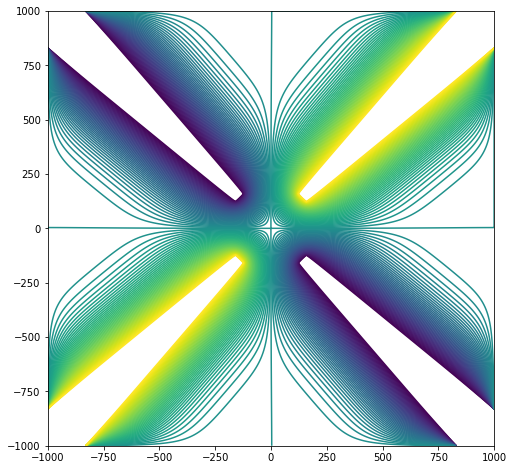

array([4470123.87935781, 4470123.87935791])

In [37]:
solve_geometry(45,5)

In [67]:
for i in range(25,66):
    a.append(b)

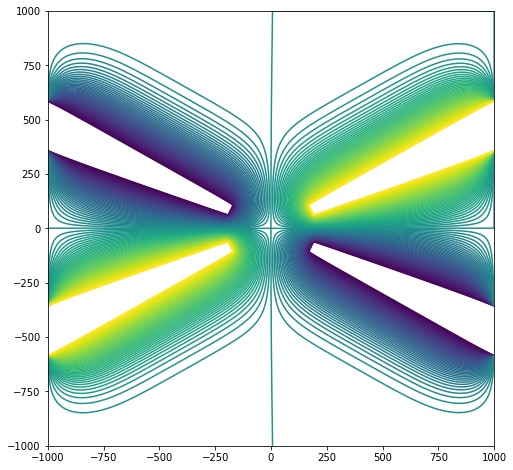

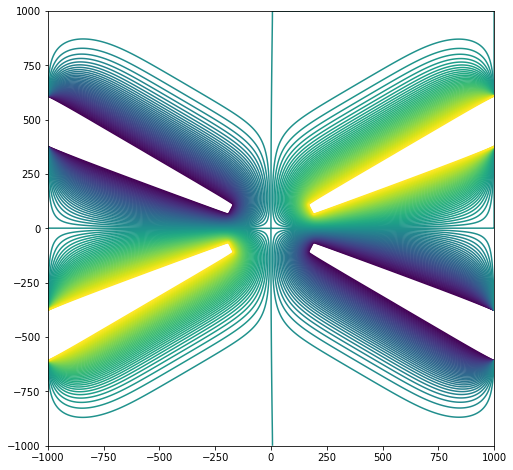

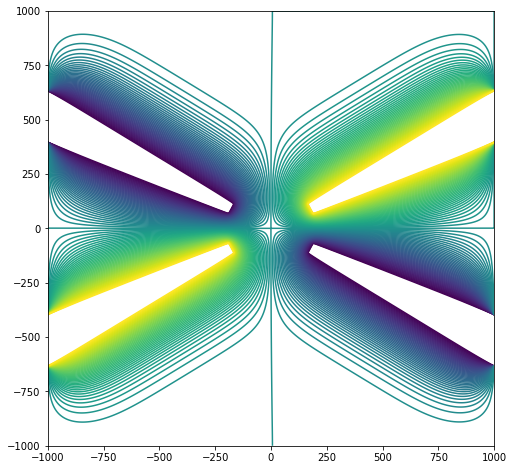

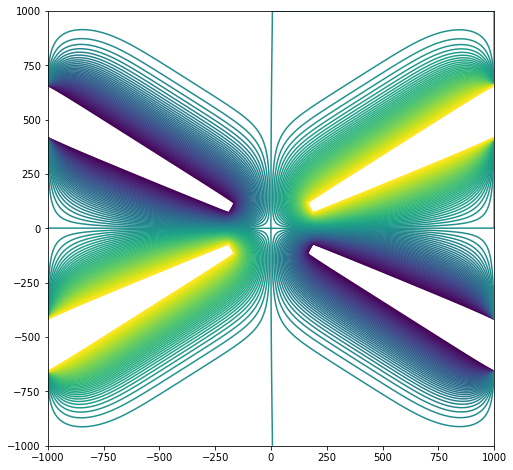

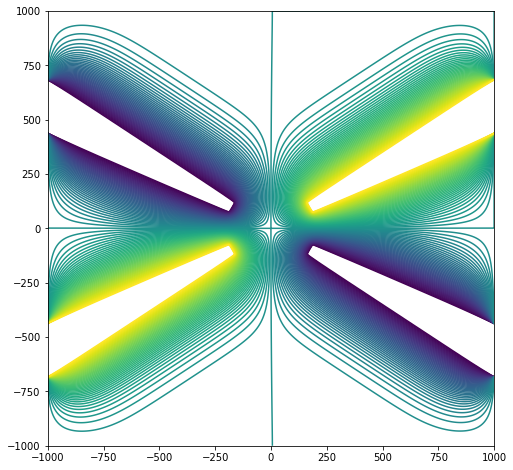

...

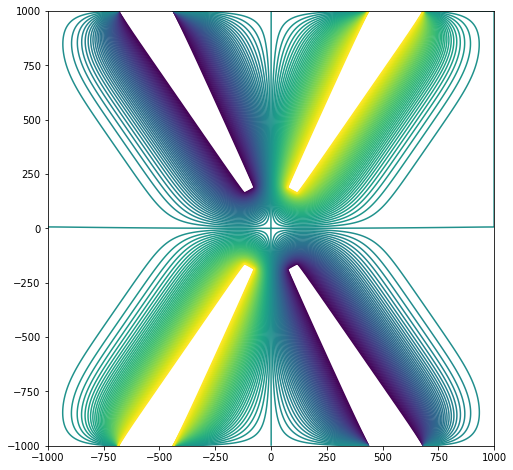

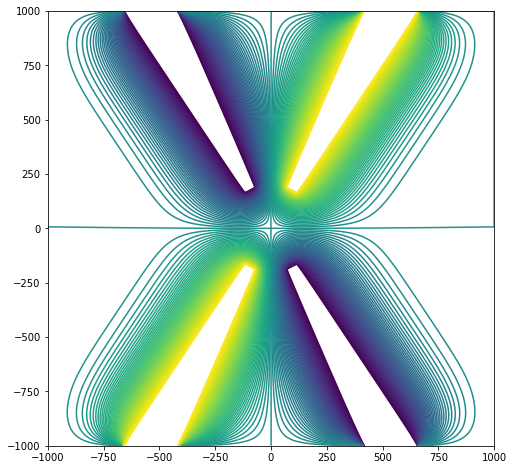

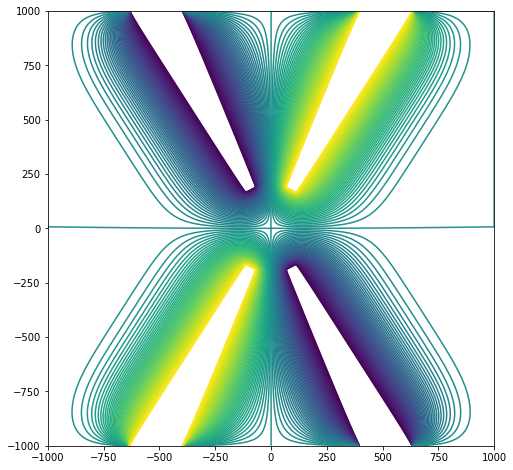

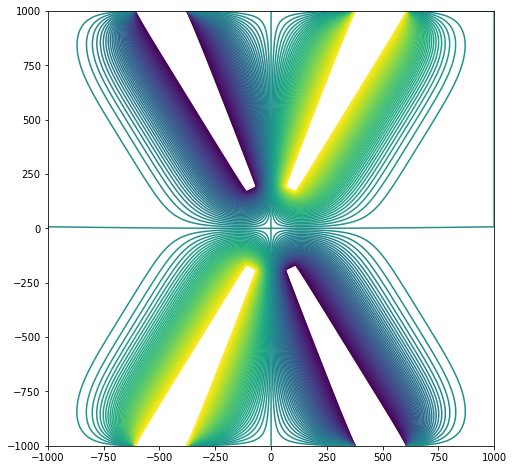

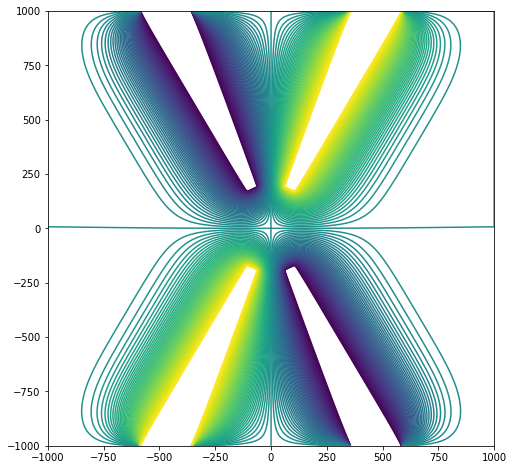

In [74]:
for i in range(25,66):
    b = solve_geometry(i,5)
    a.append(b)

In [75]:
freq_data = a

[array([3725308.23806305, 3706786.28464511]),
 array([3792486.90187435, 3774539.67512874]),
 array([3858977.2717605 , 3841634.01493123]),
 array([3919193.46773589, 3902527.11712434]),
 array([3972283.40401441, 3956306.84572079]),
 array([4027816.12457324, 4012588.89201601]),
 array([4084850.18459621, 4070425.59563097]),
 array([4137979.38516795, 4124361.00785865]),
 array([4180694.78976479, 4168007.58502249]),
 array([4221737.91964357, 4209972.45869145]),
 array([4265815.01352587, 4254989.58212311]),
 array([4298950.51520582, 4289131.64327215]),
 array([4337010.25835602, 4328211.73596263]),
 array([4365179.23320917, 4357400.58883508]),
 array([4392023.79772564, 4385329.6489001 ]),
 array([4410407.15243584, 4404764.8670019 ]),
 array([4428621.79292126, 4424094.16225326]),
 array([4438974.93838671, 4435551.06093497]),
 array([4450287.38849594, 4448014.57021516]),
 array([4451115.13940596, 4449991.38049807]),
 array([4470123.87935781, 4470123.87935791]),
 array([4449991.38036074, 4451115.

In [79]:
w_x = []
w_y = []
delta = []
for i in a:
    w_x.append(i[0])
    w_y.append(i[1])
    delta.append(i[0] - i[1])
w_x = np.array(w_x)
w_y = np.array(w_y)
delta = np.array(delta)

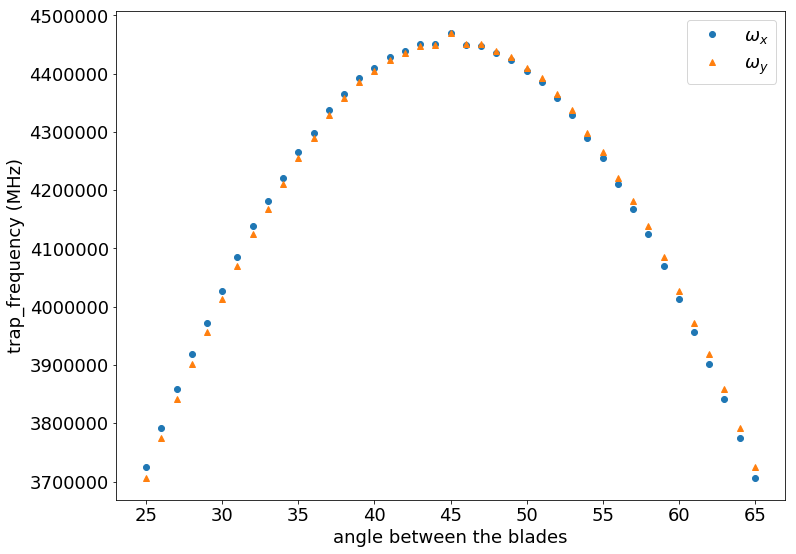

In [126]:
angle  = range(25,66)
fig = plt.figure(figsize = (12,9))
ax1 = fig.add_subplot(111)
ax1.plot(angle,w_x,'o', label = '$\omega_x$')
ax1.plot(angle,w_y,'^', label = '$\omega_y$')
ax1.set_xlabel('angle between the blades')
ax1.set_ylabel('trap_frequency (MHz)')
ax1.legend()
plt.savefig('trap_frequencies.jpg')
plt.show()


In [81]:
np.save('blade_trap_data/x_freqs.npy',w_x)
np.save('blade_trap_data/y_freqs.npy',w_y)

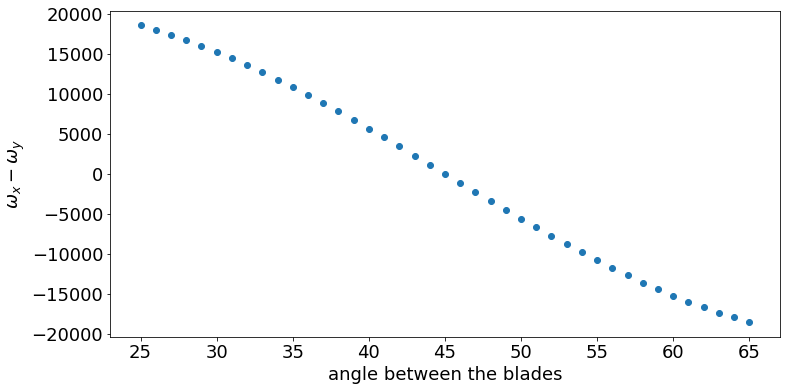

In [128]:
angle  = range(25,66)
fig = plt.figure(figsize = (12,6))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('angle between the blades')
ax1.set_ylabel('$\omega_x - \omega_y$')
ax1.plot(angle,delta,'o')
plt.savefig('frequency_seperation.jpg')
plt.show()


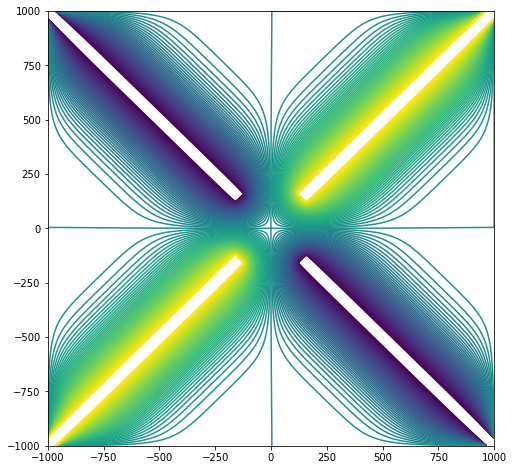

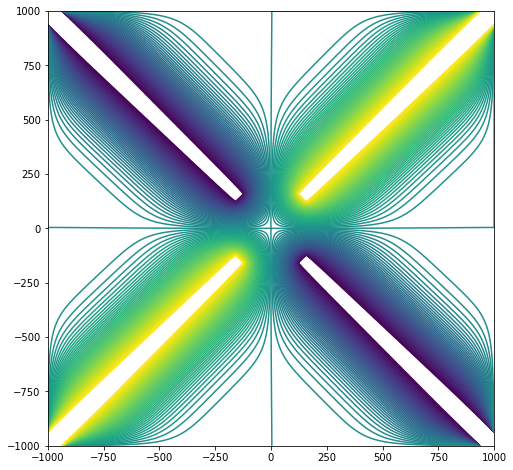

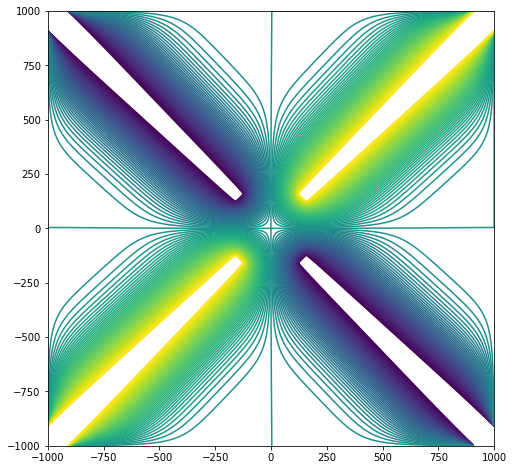

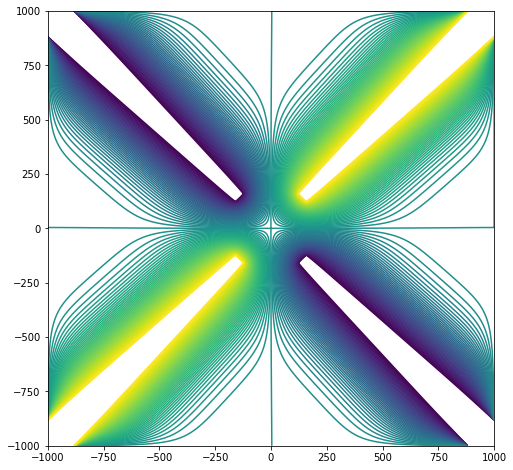

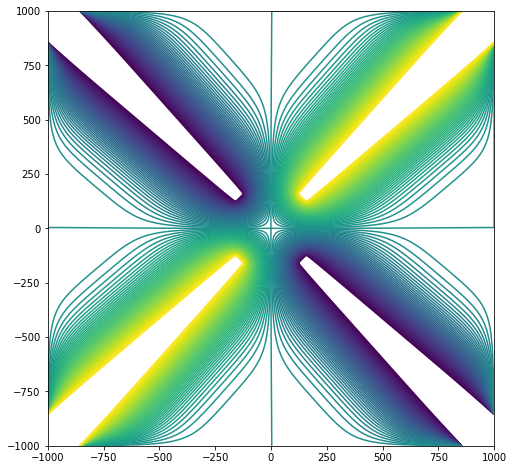

...

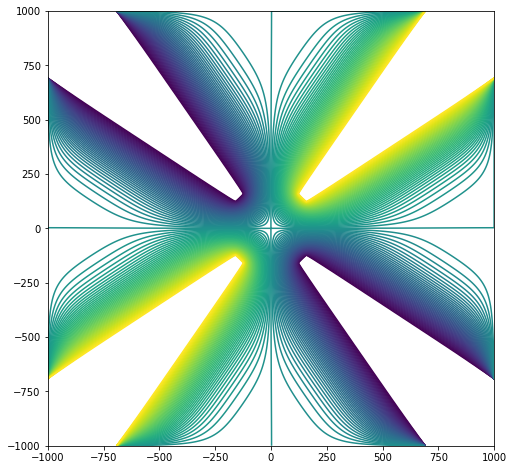

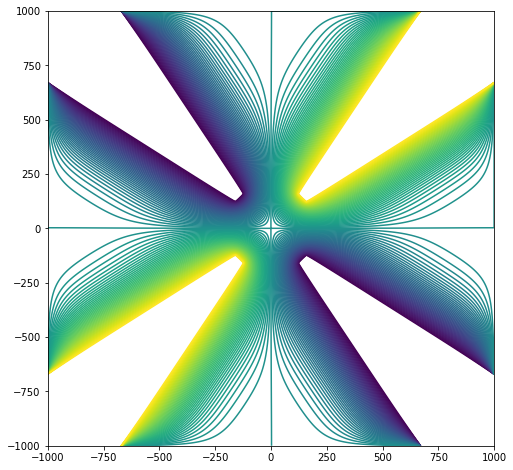

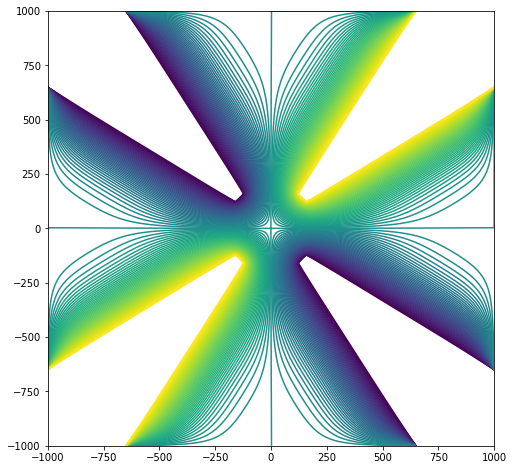

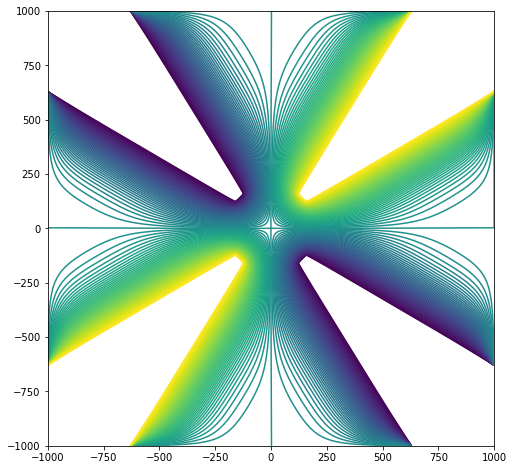

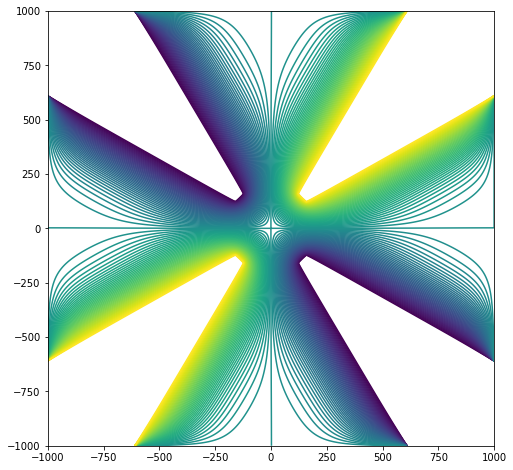

In [105]:
chamfer_data_45 = []
for i in range(0,16):
    b = solve_geometry(45,i)
    chamfer_data_45.append(b)
    

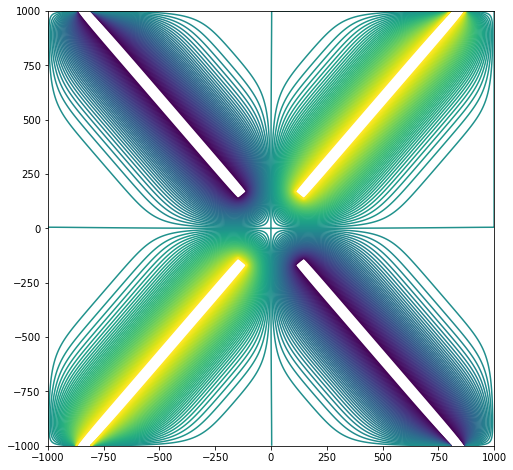

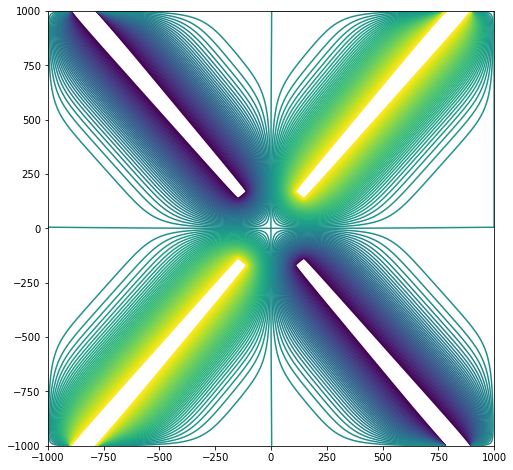

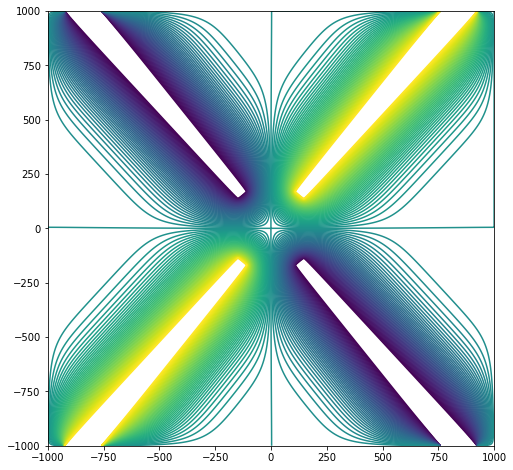

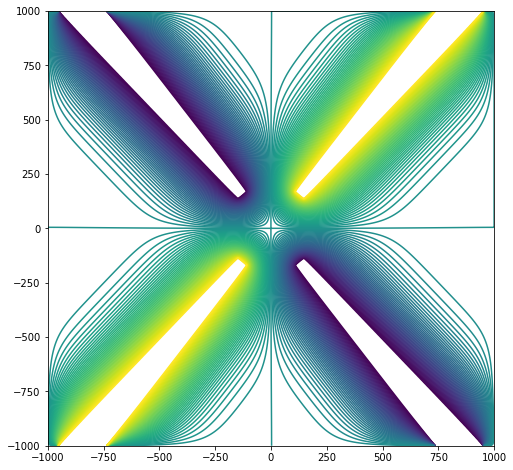

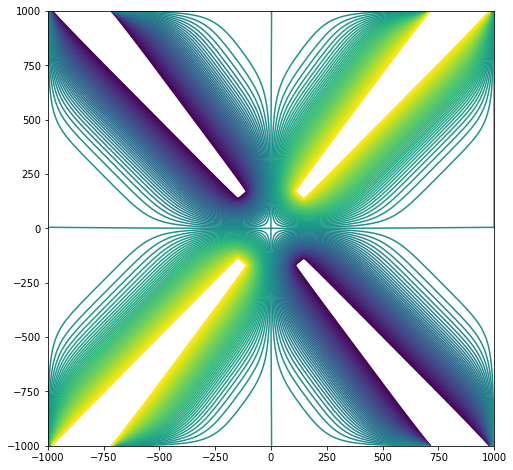

...

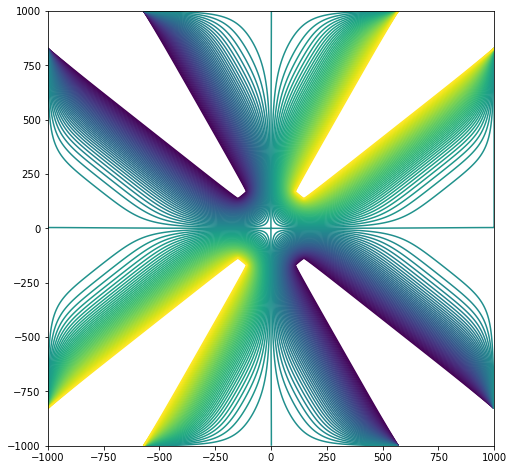

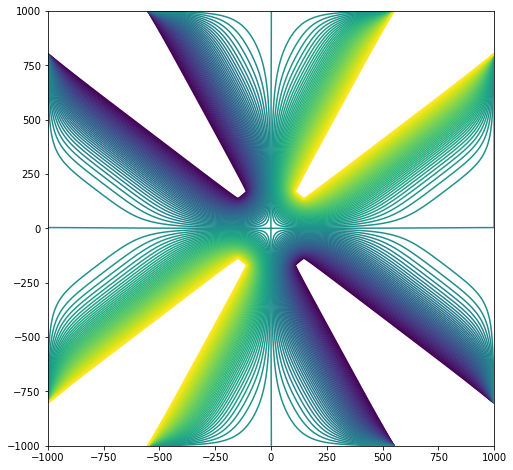

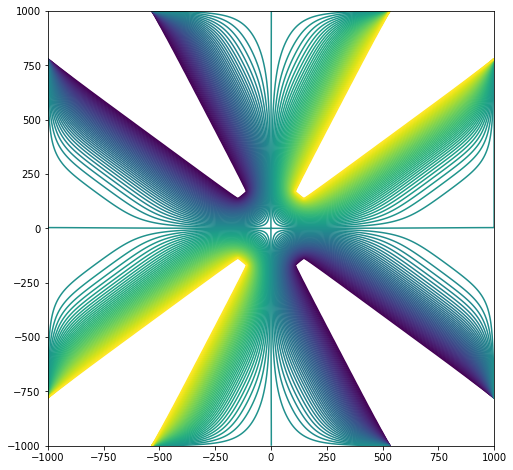

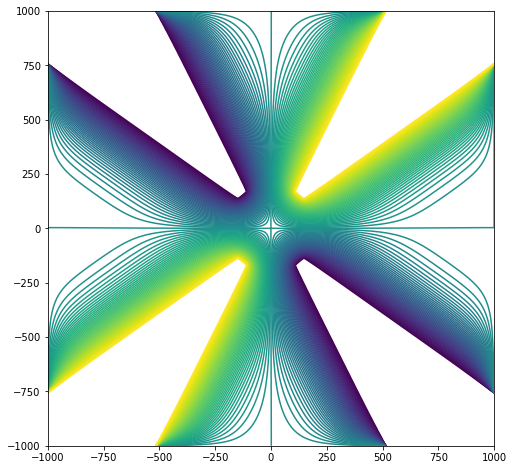

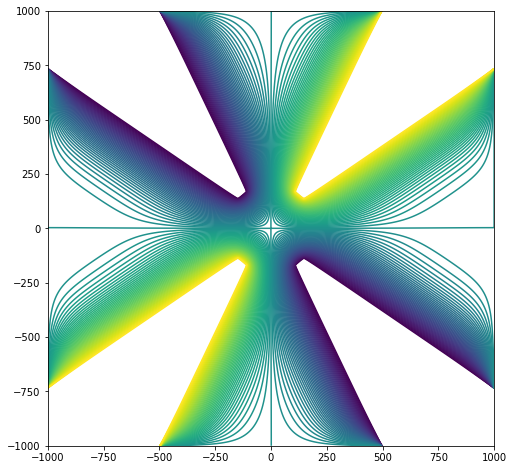

In [106]:
chamfer_data_50 = []
for i in range(0,16):
    b = solve_geometry(50,i)
    chamfer_data_50.append(b)
    

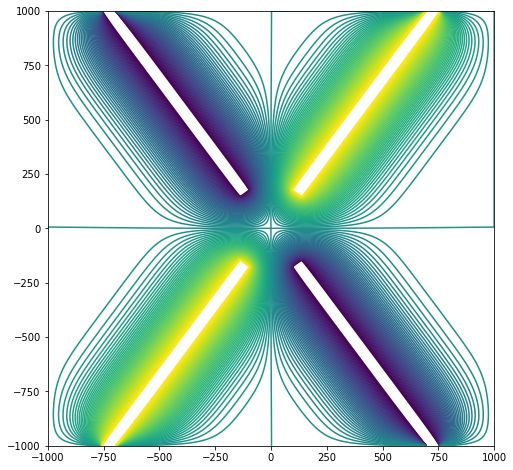

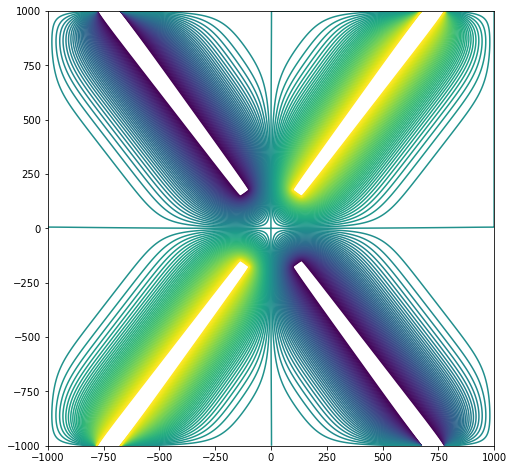

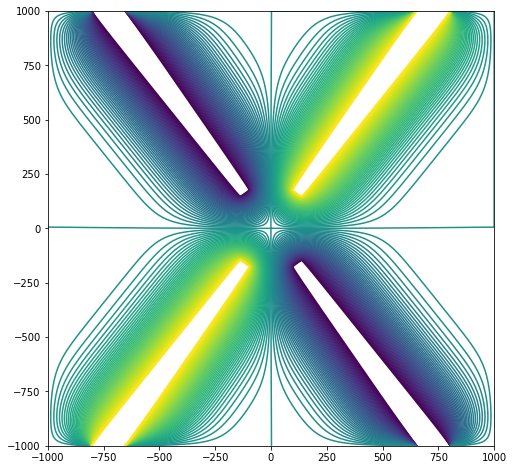

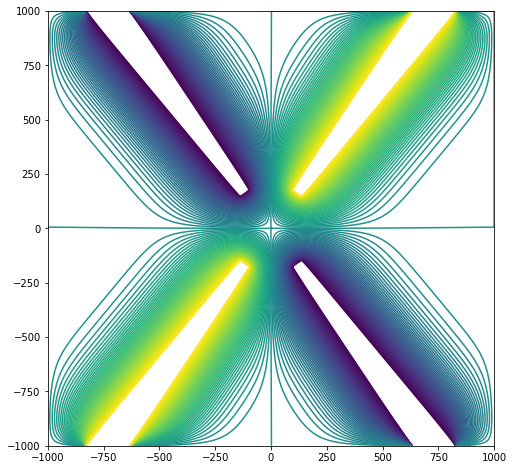

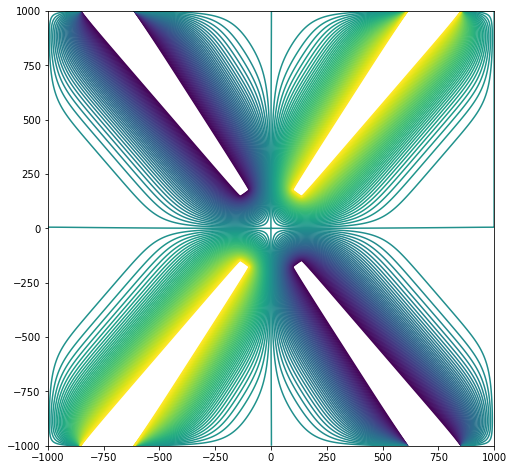

...

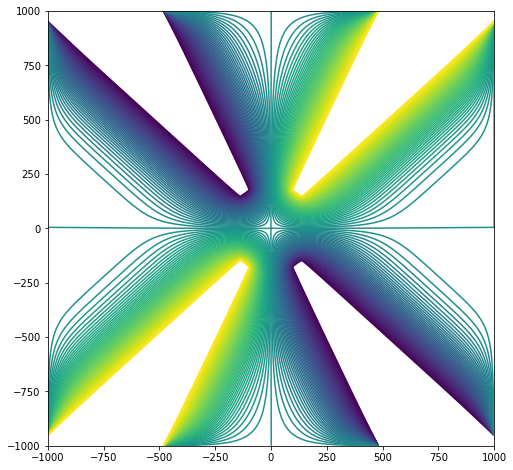

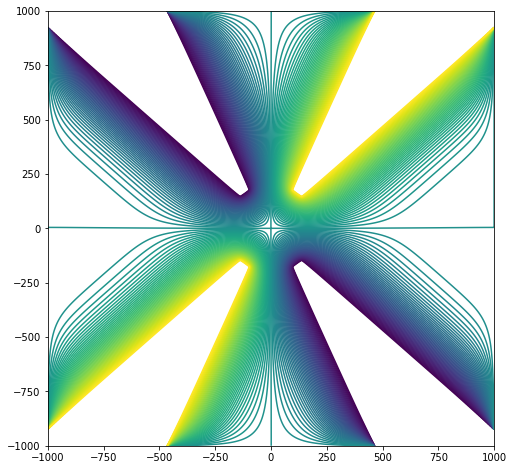

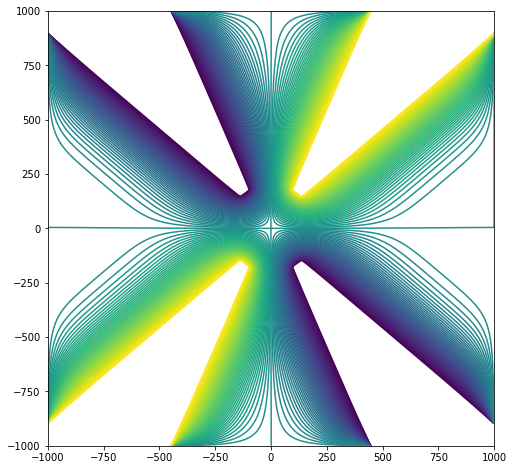

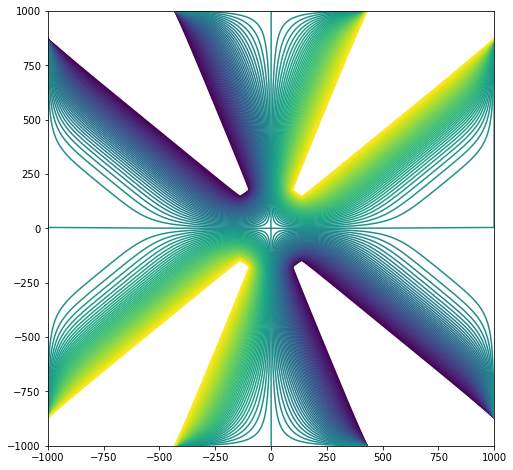

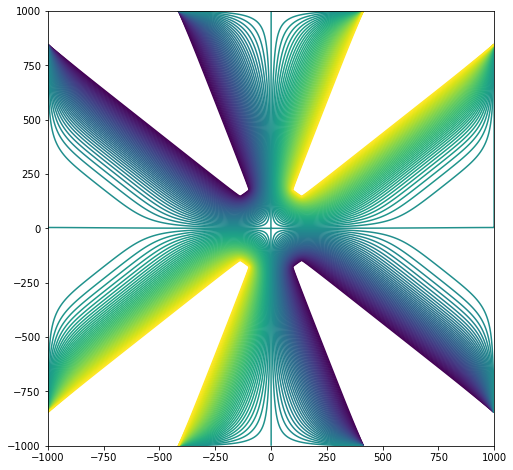

In [107]:
chamfer_data_54 = []
for i in range(0,16):
    b = solve_geometry(54,i)
    chamfer_data_54.append(b)

In [111]:
w_x_45 = []
w_y_45 = []
delta_45 = []
for i in chamfer_data_45:
    w_x_45.append(i[0])
    w_y_45.append(i[1])
    delta_45.append(i[0] - i[1])
w_x_45 = np.array(w_x_45)
w_y_45 = np.array(w_y_45)
delta_45 = np.array(delta_45)

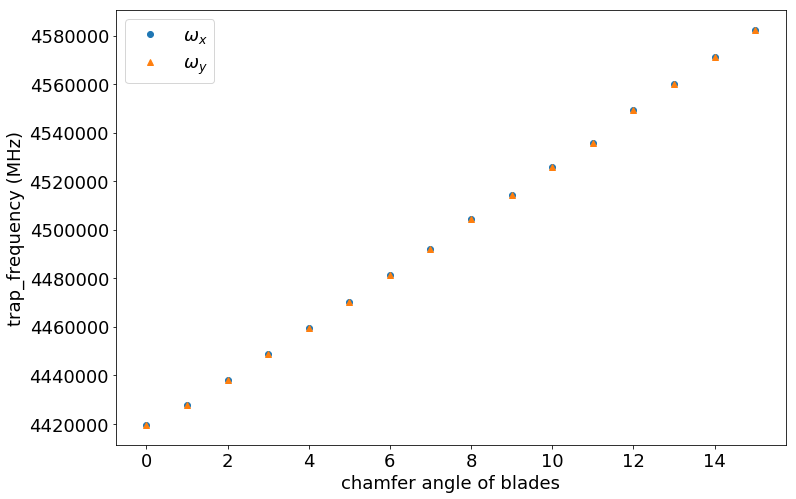

In [129]:
angle  = range(0,16)
fig = plt.figure(figsize = (12,8))
ax1 = fig.add_subplot(111)
ax1.plot(angle,w_x_45,'o', label = '$\omega_x$')
ax1.plot(angle,w_y_45,'^', label = '$\omega_y$')
ax1.set_xlabel('chamfer angle of blades')
ax1.set_ylabel('trap_frequency (MHz)')
ax1.legend()
#plt.savefig('blade_trap_data/Pictures/blade_chamfer/chamfer_angle_dependence.jpg')
plt.show()


In [114]:
w_x_50 = []
w_y_50 = []
delta_50 = []
for i in chamfer_data_50:
    w_x_50.append(i[0])
    w_y_50.append(i[1])
    delta_50.append(i[0] - i[1])
w_x_50 = np.array(w_x_50)
w_y_50 = np.array(w_y_50)
delta_50 = np.array(delta_50)

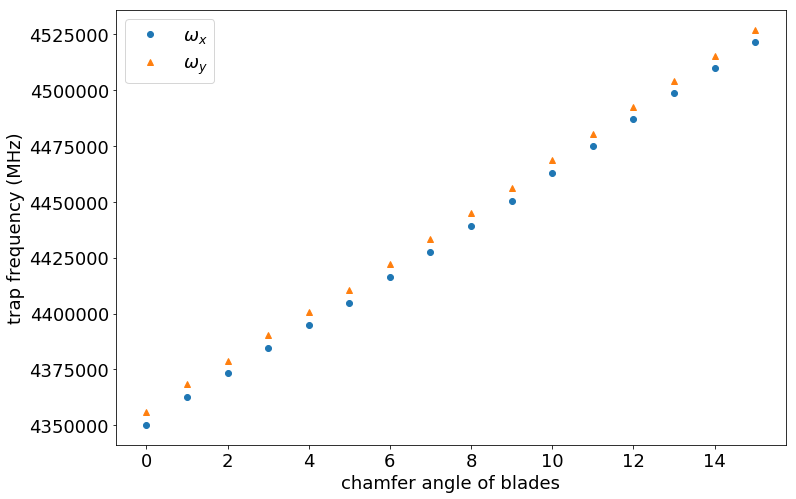

In [131]:
angle  = range(0,16)
fig = plt.figure(figsize = (12,8))
ax1 = fig.add_subplot(111)
ax1.plot(angle,w_x_50,'o', label = '$\omega_x$')
ax1.plot(angle,w_y_50,'^', label = '$\omega_y$')
ax1.set_xlabel('chamfer angle of blades')
ax1.set_ylabel('trap frequency (MHz)')
ax1.legend()
#plt.savefig('blade_trap_data/Pictures/blade_chamfer/Theta_50/chamfer_angle_dependence.jpg')
plt.show()


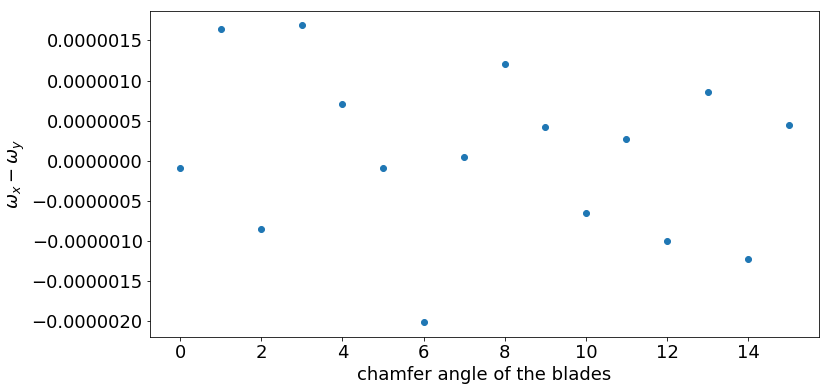

In [136]:
angle  = range(0,16)
fig = plt.figure(figsize = (12,6))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('chamfer angle of the blades')
ax1.set_ylabel('$\omega_x - \omega_y$')
ax1.plot(angle,delta_45,'o')
#plt.savefig('frequency_seperation.jpg')
plt.show()


In [125]:
plt.rcParams.update({'font.size': 18})

In [132]:
w_x_54 = []
w_y_54 = []
delta_54 = []
for i in chamfer_data_54:
    w_x_54.append(i[0])
    w_y_54.append(i[1])
    delta_54.append(i[0] - i[1])
w_x_54 = np.array(w_x_54)
w_y_54 = np.array(w_y_54)
delta_54 = np.array(delta_54)

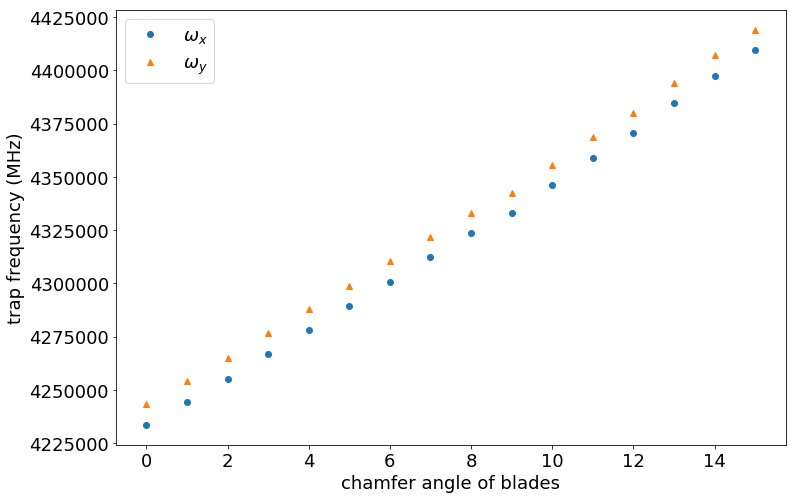

In [135]:
angle  = range(0,16)
fig = plt.figure(figsize = (12,8))
ax1 = fig.add_subplot(111)
ax1.plot(angle,w_x_54,'o', label = '$\omega_x$')
ax1.plot(angle,w_y_54,'^', label = '$\omega_y$')
ax1.set_xlabel('chamfer angle of blades')
ax1.set_ylabel('trap frequency (MHz)')
ax1.legend()
#plt.savefig('blade_trap_data/Pictures/blade_chamfer/Theta_54/chamfer_angle_dependence.jpg')
plt.show()

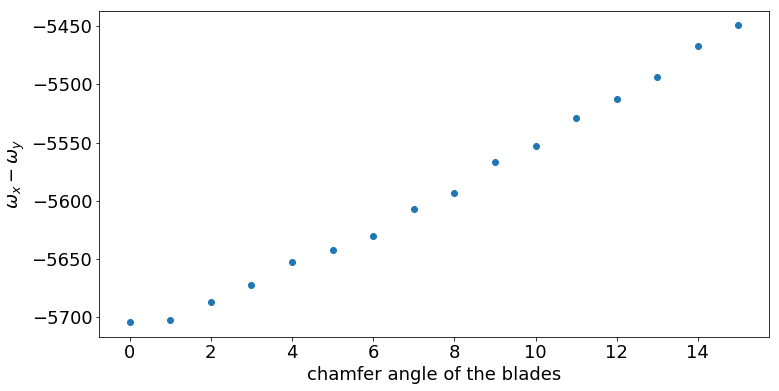

In [141]:
angle  = range(0,16)
fig = plt.figure(figsize = (12,6))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('chamfer angle of the blades')
ax1.set_ylabel('$\omega_x - \omega_y$')
ax1.plot(angle,delta_50,'o')
#plt.savefig('blade_trap_data/Pictures/blade_chamfer/Theta_50/frequency seperation with chamfer.jpg')
plt.show()


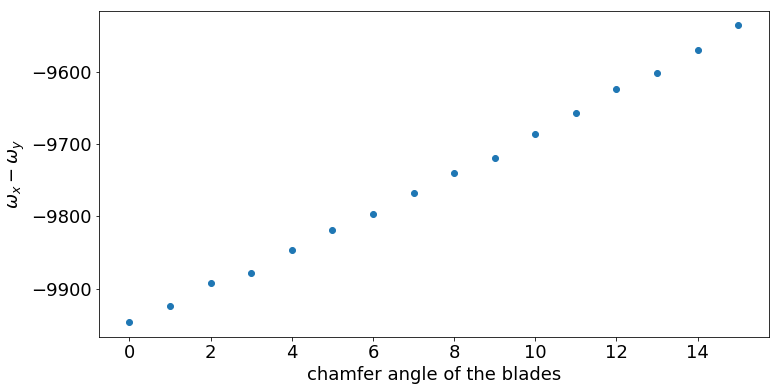

In [142]:
angle  = range(0,16)
fig = plt.figure(figsize = (12,6))
ax1 = fig.add_subplot(111)
ax1.set_xlabel('chamfer angle of the blades')
ax1.set_ylabel('$\omega_x - \omega_y$')
ax1.plot(angle,delta_54,'o')
#plt.savefig('blade_trap_data/Pictures/blade_chamfer/Theta_54/frequency seperation with chamfer.jpg')
plt.show()